In [4]:
%load_ext autoreload
%autoreload 2

# load dependencies
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
from datetime import datetime
import pysal 
import libpysal #added
pd.options.mode.chained_assignment = None 
from geofeather import to_geofeather, from_geofeather
from matplotlib import pyplot as plt
from pysal.explore import esda
import numpy as np
from pyproj import CRS
from pyproj import Transformer
import feather
#import skmob

from envirocar import TrackAPI, DownloadClient, BboxSelector, ECConfig

# create an initial but optional config and an api client
config = ECConfig()
track_api = TrackAPI(api_client=DownloadClient(config=config))

C:\Users\shres\anaconda3\envs\geo_env\lib\site-packages\pysal\explore\segregation\network\network.py:15: UserWarning: You need pandana and urbanaccess to work with segregation's network module
You can install them with  `pip install urbanaccess pandana` or `conda install -c udst pandana urbanaccess`
  warn(
C:\Users\shres\anaconda3\envs\geo_env\lib\site-packages\pysal\model\spvcm\abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


## Functions

In [4]:
inputCRS = CRS.from_epsg(4326)
outputCRS = CRS.from_epsg(25832)
transformer = Transformer.from_crs(inputCRS, outputCRS)
def project(a,b):
    return transformer.transform(a, b)

In [5]:
def getisOrd(data, value = 'value', threshold = 50, lat = 'lat', lng = 'lng'):
    coords = [project(row[lat], row[lng]) for index, row in data.iterrows()]
    w = libpysal.weights.DistanceBand(coords, threshold)         #w = pysal.weights.DistanceBand(coords, threshold)
    #getisOrdGlobal = esda.getisord.G(data_speed['time_sec'], w)
    getisOrdLocal = esda.getisord.G_Local(data[value], w, transform='B')
    getisOrdLocal.Zs

    data['z_score'] = getisOrdLocal.Zs
    data['p_value'] = getisOrdLocal.p_norm

    return data

In [6]:
def pltcolor(p_value, z_score, confidence):
    cols=[]
    size=[]
    for p, z in zip(p_value, z_score):
        if p < confidence:
            if z > 0:
                cols.append('red')        #hotspot color
                size.append(20)
            else:
                cols.append('blue')       #coldspot color
                size.append(20)
        else:
            cols.append('grey')           #others
            size.append(10)
    return cols , size

In [7]:
def plot(data, lat = 'lat', lng = 'lng', p_field = 'p_value', z_field = 'z_score'):
    from matplotlib import pyplot as plt
    #z_score>1.96 hot spots (95% ci)
    #z_score<-1.96 cold spots
    from matplotlib import colors as cls

    f, axarr = plt.subplots(1, figsize=(10,10))
    total_range = cls.Normalize(vmin = - 1.96, vmax = 1.96)
    
    cols, sizes = pltcolor(data[p_field], data[z_field], 0.05)

    plt.scatter(x=data['lng'], y=data['lat'], s=sizes, c=cols, lw = 0) #Pass on the list created by the function here
    plt.grid(True)
    plt.show()

In [8]:
def makepopup(t):
        return str(t)

In [9]:
def map(data, value = 'value', lat = 'lat', lng = 'lng', p_field = 'p_value', z_field = 'z_score'):
    import folium

    lats = data[lat]
    lngs = data[lng]

    #z-value
    z = data[z_field]
    p = data[p_field]

    avg_lat = sum(lats) / len(lats)
    avg_lngs = sum(lngs) / len(lngs)

    m = folium.Map(location=[avg_lat, avg_lngs], tiles = 'Stamen Terrain', zoom_start=12)

    color, sizes = pltcolor(p, z, 0.05)
    value = data[value]

    
    for lat,lng,c,s,v in zip(lats, lngs, color, sizes, value):
        folium.CircleMarker([lat,lng], color = c, radius = s/3, fill = c, popup = makepopup(v)).add_to(m)
    m
    return m

# Data Import
EnviroCar tracks data is imported and saved in geofeather format, which is a faster for geometries with geopandas. Tracks are also clipped by the initial bounding box to cut out the tracks extending beyond the extent of bounding box.

In [5]:
## Mönchengladbach bbox coordinates
bbox = BboxSelector([
    6.3301849365234375, # min_x
    51.13369295212583, # min_y
    6.540985107421875, # max_x
    51.23870648334856  # max_y
])
# issue a query
track_df = track_api.get_tracks(bbox=bbox, num_results=500) # requesting 500 tracks inside the bbox
track_df.head()

,id,time,geometry,GPS Bearing.value,GPS Bearing.unit,Intake Temperature.value,Intake Temperature.unit,MAF.value,MAF.unit,Intake Pressure.value,...,Consumption.value,Consumption.unit,Throttle Position.value,Throttle Position.unit,track.appVersion,track.touVersion,O2 Lambda Voltage.value,O2 Lambda Voltage.unit,O2 Lambda Voltage ER.value,O2 Lambda Voltage ER.unit
0,5b46294f44ea850910a1c1e0,2018-07-11T06:07:23,POINT (6.41455 51.20328),117.943870,deg,28.000001,c,35.669282,l/s,120.000001,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5b46294f44ea850910a1c1e2,2018-07-11T06:07:28,POINT (6.41512 51.20308),115.088323,deg,28.000000,c,31.446508,l/s,113.073678,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5b46294f44ea850910a1c1e3,2018-07-11T06:07:33,POINT (6.41564 51.20299),106.541059,deg,28.000000,c,28.072108,l/s,112.068772,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5b46294f44ea850910a1c1e4,2018-07-11T06:07:38,POINT (6.41615 51.20291),99.885196,deg,28.000000,c,33.429661,l/s,129.759303,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5b46294f44ea850910a1c1e5,2018-07-11T06:07:43,POINT (6.41671 51.20282),104.435649,deg,27.999999,c,25.774274,l/s,106.020177,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
#bounding box polygon in geodataframe
from shapely.geometry import Polygon
bboxpoly = Polygon([(6.3301849365234375, 51.13369295212583,), 
                                       (6.540985107421875,51.13369295212583), 
                                       (6.540985107421875, 51.23870648334856 ), 
                                       (6.3301849365234375,51.23870648334856)])
bboxpoly_gdf = gpd.GeoDataFrame([1],geometry=[bboxpoly])

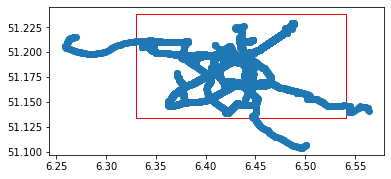

In [7]:
#plotting the tracks and bounding box shows the extending tracks
base = bboxpoly_gdf.plot(color='white', edgecolor='red')
track_df.plot(ax=base)

In [8]:
#clipping track_df by bboxpoly_gdf
track_df_copy = track_df.reset_index(drop = True)
clipTracks_df = gpd.clip(track_df_copy, bboxpoly_gdf)

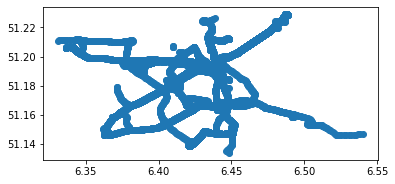

In [9]:
clipTracks_df.plot()

In [10]:
#conversion to feather format
data_path = 'Data/Monchengladbach_500.feather'
clipTracks_df.reset_index(inplace = True)
to_geofeather(clipTracks_df, data_path)

In [15]:
#importing and checking data
track_df_500 = from_geofeather('Data/Monchengladbach_500.feather')
track_df_500.columns

ArrowInvalid: Not a feather file

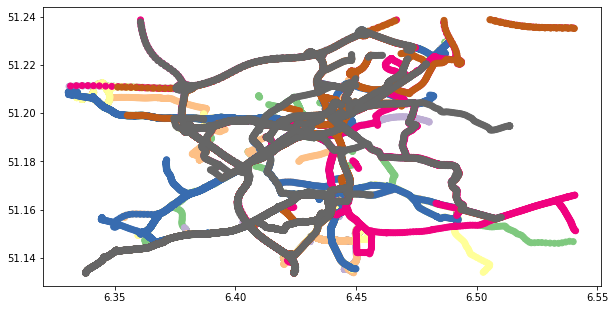

In [9]:
track_df_500.plot(figsize=(10, 12), c=track_df_500['id'], cmap = 'Accent')
#color based on track id

### Hotspots For Vehicle Speed


count    20569.000000
mean         3.667509
std          1.047842
min          0.000000
25%          3.000000
50%          3.000000
75%          5.000000
max         15.000000
Name: time_diff, dtype: float64

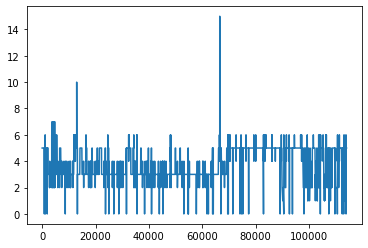

In [10]:
## select stopping times data
df_speed = track_df_500

# convert the date column to datetime type
df_speed['time_datetime'] = pd.to_datetime(df_speed['time'], format = "%Y-%m-%dT%H:%M:%S")
df_speed['time_diff'] = (df_speed['time_datetime'] - df_speed['time_datetime'].shift()).fillna(pd.Timedelta('0 days'))
df_speed['time_diff'] = df_speed['time_diff'].apply(lambda x: x.total_seconds())

##identify first record in each track and adding a default value of 0
tracks_id = (df_speed['id'].groupby(df_speed['track.id']).nth(0)).tolist()
df_speed['time_diff'][df_speed['id'].isin(tracks_id)] = 0

### select tracks with speed = 0
df_speed = df_speed[df_speed['Speed.value'] == 0]

### plot times
plt.plot(df_speed['time_diff'])
df_speed['time_diff'].describe()

count    16578.000000
mean         4.550428
std          3.553199
min          0.000000
25%          3.000000
50%          3.000000
75%          5.000000
max        130.000000
Name: time_diff, dtype: float64

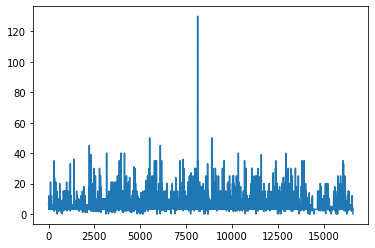

In [11]:
##get coordinates
df_speed['lat'] = df_speed['geometry'].apply(lambda coord: coord.y)
df_speed['lng'] = df_speed['geometry'].apply(lambda coord: coord.x)

## group by location
data_speed = df_speed.groupby(['lat','lng'])[['time_diff']].sum().reset_index()

### plot times
plt.plot(data_speed['time_diff'])
data_speed['time_diff'].describe()

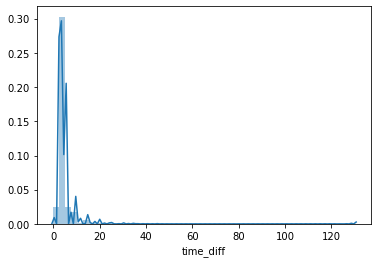

In [12]:
sns.distplot(data_speed['time_diff'])

C:\Users\shres\anaconda3\envs\geo_env\lib\site-packages\libpysal\weights\weights.py:167: UserWarning: The weights matrix is not fully connected: 
 There are 558 disconnected components.
 There are 92 islands with ids: 571, 993, 1500, 1596, 1696, 2160, 2243, 2244, 2322, 2469, 2570, 2684, 2935, 2937, 3002, 3741, 3804, 4006, 4822, 4831, 5025, 5053, 5110, 5396, 5470, 5535, 5616, 5618, 5725, 5763, 5784, 6003, 6049, 6091, 6179, 6354, 6432, 6614, 6651, 6679, 6706, 6802, 6812, 6875, 6887, 7091, 7562, 7669, 7853, 8240, 8246, 8666, 8677, 8681, 8888, 9266, 9572, 10108, 11247, 11821, 12050, 12251, 12309, 12319, 12320, 12863, 12960, 13482, 13811, 13971, 13976, 14011, 14134, 14147, 14149, 14150, 14153, 14195, 14204, 14235, 14236, 14965, 15195, 15200, 15291, 15335, 15708, 15746, 15770, 16312, 16313, 16443.
  warnings.warn(message)


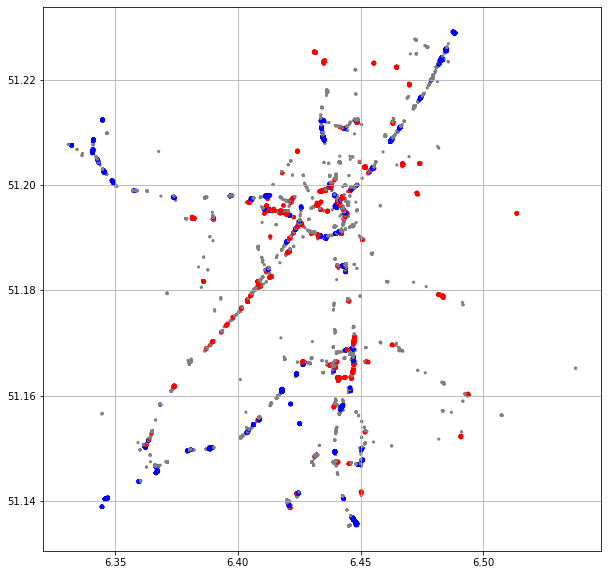

In [13]:
speedGetis = getisOrd(data_speed, 'time_diff', 30)
plot(speedGetis)

In [14]:
map(speedGetis, 'time_diff')

In [17]:
len(speedGetis[speedGetis['p_value'] < 0.05])
speedGetis

,lat,lng,time_diff,z_score,p_value
0,51.135224,6.445199,6.0,1.290525,0.098434
1,51.135225,6.445199,6.0,1.290525,0.098434
2,51.135225,6.445177,6.0,1.290525,0.098434
3,51.135225,6.445201,6.0,1.290525,0.098434
4,51.135229,6.445201,6.0,1.290525,0.098434
...,...,...,...,...,...
16573,51.229116,6.487625,3.0,-1.936995,0.026373
16574,51.229116,6.487624,3.0,-1.936995,0.026373
16575,51.229117,6.487624,3.0,-1.936995,0.026373
16576,51.229118,6.487624,3.0,-1.936995,0.026373


## Aggregation by Zip Codes

In [18]:
zip_codes = gpd.read_file('Data/MC_division.geojson')
getis_speed = gpd.GeoDataFrame(speedGetis, geometry=gpd.points_from_xy(speedGetis.lng, speedGetis.lat), crs='epsg:4326')
track_df_join = gpd.sjoin(zip_codes, getis_speed)
type(track_df_join)
speed_zip = track_df_join.dissolve(by='Nummer', aggfunc='mean')
#speed_zip.head()

C:\Users\a\anaconda3\envs\Envirocar\lib\site-packages\geopandas\tools\sjoin.py:58: UserWarning: CRS of frames being joined does not match!({'init': 'epsg:4326'} != epsg:4326)
  warn(


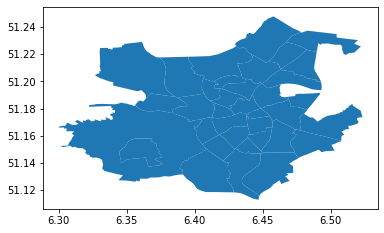

In [19]:
speed_zip.plot()

In [25]:
time_diff = speed_zip['time_diff']
w = pysal.lib.weights.Queen.from_dataframe(speed_zip)
moran_time = esda.Moran_Local(time_diff, w, permutations=9999)
sig = moran_time.p_sim < 0.10
hotspots = moran_time.q==1 * sig
coldspots = moran_time.q==3 * sig


array([ True,  True, False, False,  True, False, False, False, False,
       False, False, False, False, False, False, False,  True, False,
       False,  True, False, False, False,  True, False, False, False,
        True,  True,  True, False,  True, False, False, False, False])

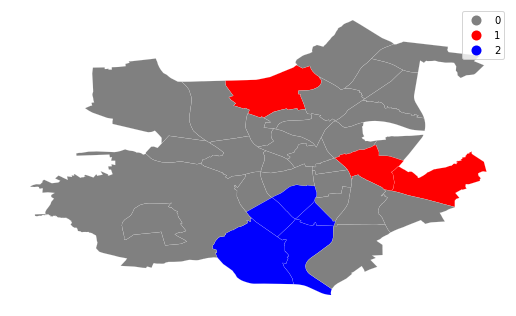

In [21]:
from matplotlib import colors
hcmap = colors.ListedColormap(['grey', 'red','blue'])
hotcold = hotspots*1 + coldspots*2
f, ax = plt.subplots(1, figsize=(9, 9))
speed_zip.assign(cl=hotcold).plot(column='cl', categorical=True, \
        k=2, cmap=hcmap,linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

In [ ]:
import folium
m = folium.Map(location=[center_lat, center_lng], tiles = 'Stamen Terrain', zoom_start=12)

folium.GeoJson(
    speed_zip,
    style_function= lambda feature:{
        'fillColor': '#ada8a7',
        'color' : '#f7f7f7',
        'weight' : 1,
        'fillOpacity' : 0.7,
    }
).add_to(m)

folium.GeoJson(
    speed_zip[hotspots],
    style_function= lambda feature:{
        'fillColor': '#ea6348',
        'color' : '#f7f7f7',
        'weight' : 1,
        'fillOpacity' : 0.7,
    }
).add_to(m)

folium.GeoJson(
    speed_zip[coldspots],
    style_function= lambda feature:{
        'fillColor': '#5990ed',
        'color' : '#f7f7f7',
        'weight' : 1,
        'fillOpacity' : 0.7,
    }
).add_to(m)

lats = speedGetis['lat']
lngs = speedGetis['lng']

#z-value
z = speedGetis['z_score']
p = speedGetis['p_value']

avg_lat = sum(lats) / len(lats)
avg_lngs = sum(lngs) / len(lngs)


color, sizes = pltcolor(p, z, 0.05)
value = speedGetis['time_diff']


for lat,lng,c,s,v in zip(lats, lngs, color, sizes, value):
    folium.CircleMarker([lat,lng], color = c, radius = 2, fill = c, popup = makepopup(v)).add_to(m)
m

In [26]:
traffic_lights = gpd.read_file('Data/Traffic_lights.shp')
traffic_lights.head()

,id,@id,highway,traffic_si,crossing,TMC_cid_58,TMC_cid__1,TMC_cid__2,TMC_cid__3,TMC_cid__4,...,tactile_pa,traffic_ca,ele,maxspeed,side,descriptio,foot,crossing_i,kerb,geometry
0,node/87225547,node/87225547,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.46556 51.21058)
1,node/87225564,node/87225564,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47429 51.21641)
2,node/87225575,node/87225575,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47925 51.22051)
3,node/87225834,node/87225834,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.46336 51.21235)
4,node/87225893,node/87225893,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47456 51.20406)


In [32]:
traffic_lights_proj = traffic_lights.to_crs('EPSG:25832')
traffic_lights_proj['geometry'] = traffic_lights_proj.geometry.buffer(20)

C:\Users\a\anaconda3\envs\Envirocar\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [65]:
getis_speed = getis_speed.to_crs('EPSG:25832')
# print(len(getis_speed))
lights_speed = gpd.sjoin(getis_speed,traffic_lights_proj,op='within').reset_index()
# print(len(lights_speed))
lights_speed.head()

,index,lat,lng,time_diff,z_score,p_value,geometry,index_right,id,@id,...,note,tactile_pa,traffic_ca,ele,maxspeed,side,descriptio,foot,crossing_i,kerb
0,155,51.136063,6.447746,3.0,-1.810887,0.035079,POINT (321446.190 5668053.204),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
1,160,51.136088,6.447826,3.0,-2.215731,0.013355,POINT (321451.843 5668055.842),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
2,161,51.136090,6.447826,12.0,-2.552398,0.005349,POINT (321451.863 5668056.011),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
3,163,51.136091,6.447826,3.0,-2.175010,0.014815,POINT (321451.882 5668056.180),324,node/127442782,node/127442782,...,None,None,None,None,None,None,None,None,None,None
4,303,51.138685,6.421340,21.0,9.206934,0.000000,POINT (319609.345 5668409.214),330,node/4909133140,node/4909133140,...,None,None,None,None,None,None,None,None,None,None


In [76]:
import folium
m = folium.Map(location=[center_lat, center_lng], tiles = 'Stamen Terrain', zoom_start=12)

#hotspots not near the signal
getis_speed_wgs = getis_speed.to_crs('EPSG:4326')
getis_speed_wgs['lat'] = getis_speed_wgs['geometry'].apply(lambda coord: coord.y)
getis_speed_wgs['lng'] = getis_speed_wgs['geometry'].apply(lambda coord: coord.x)
getis_lats = getis_speed_wgs['lat']
getis_lngs = getis_speed_wgs['lng']

center_getis_lat = sum(getis_lats)/len(getis_lats)
center_getis_lng = sum(getis_lngs)/len(getis_lngs)

for getis_lat,getis_lng in zip(getis_lats, getis_lngs):
        folium.CircleMarker([getis_lat,getis_lng], color = '#17b4e9', fill=True, radius=1).add_to(m)

#hotspots near the traffic signals
lights_speed_wgs = lights_speed.to_crs('EPSG:4326')
lights_speed_wgs['lat'] = lights_speed_wgs['geometry'].apply(lambda coord: coord.y)
lights_speed_wgs['lng'] = lights_speed_wgs['geometry'].apply(lambda coord: coord.x)
lats = lights_speed_wgs['lat']
lngs = lights_speed_wgs['lng']

center_lat = sum(lats)/len(lats)
center_lng = sum(lngs)/len(lngs)

for lat,lng in zip(lats, lngs):
        folium.CircleMarker([lat,lng], color = '#d02a18', fill=True, radius=1).add_to(m)
m

### Hotspots For CO2 Emmission

In [ ]:
track_df_500['CO2.value'].describe()

In [ ]:
CO2 = track_df_500.dropna(subset = ['CO2.value'])
len(CO2)

In [ ]:
CO2['lat'] = CO2['geometry'].apply(lambda coord: coord.y)
CO2['lng'] = CO2['geometry'].apply(lambda coord: coord.x)
CO2['CO2'] = CO2['CO2.value']
# df_CO2.head()
data_CO2 = CO2.groupby(['lat','lng'])[['CO2']].sum().reset_index()
data_CO2.head()

In [ ]:
getisCO2 = getisOrd(data_CO2, 'CO2', 50)
plot(getisCO2)

In [ ]:
map(getisCO2, 'CO2')

### Hotspots For Fuel Consumption

In [11]:
track_df_500['Consumption.value'].describe()

count    78549.000000
mean         2.136787
std          2.803767
min          0.000000
25%          0.000000
50%          0.956715
75%          3.072414
max         30.357302
Name: Consumption.value, dtype: float64

In [12]:
track_df_500['Consumption.unit'].describe()

count     78549
unique        1
top         l/h
freq      78549
Name: Consumption.unit, dtype: object

In [13]:
Consumption = track_df_500.dropna(subset = ['Consumption.value'])
len(Consumption)

78549

In [14]:
Consumption['lat'] = Consumption['geometry'].apply(lambda coord: coord.y)
Consumption['lng'] = Consumption['geometry'].apply(lambda coord: coord.x)
Consumption['Consumption'] = Consumption['Consumption.value']

data_Consumption = Consumption.groupby(['lat','lng'])[['Consumption']].sum().reset_index()
data_Consumption.head()

,lat,lng,Consumption
0,51.133700,6.424356,6.025879
1,51.133704,6.424346,0.689118
2,51.133716,6.337975,1.987331
3,51.133719,6.424336,8.315652
4,51.133720,6.424357,7.371338


In [14]:
getisConsumption = getisOrd(data_Consumption, 'Consumption', 30)


C:\Users\shres\anaconda3\envs\geo_env\lib\site-packages\libpysal\weights\weights.py:167: UserWarning: The weights matrix is not fully connected: 
 There are 1379 disconnected components.
 There are 730 islands with ids: 25, 66, 150, 196, 198, 260, 366, 773, 1063, 1315, 1476, 1609, 1629, 1637, 1755, 1832, 2180, 2567, 2991, 3219, 3414, 3427, 3471, 3648, 3681, 3705, 3706, 3709, 3710, 3719, 3880, 3939, 4242, 4441, 4661, 4840, 5104, 5194, 5350, 5399, 5601, 5655, 5979, 6069, 6151, 6155, 6201, 6243, 6256, 6267, 6268, 6281, 6327, 6333, 6537, 6550, 6597, 6735, 6742, 6783, 6882, 7095, 7252, 7302, 7602, 7669, 8246, 8272, 8291, 8707, 8795, 8884, 9215, 9349, 9553, 9742, 10010, 10168, 11024, 11073, 11554, 11689, 11735, 11793, 11794, 11803, 11816, 11829, 11830, 11831, 11837, 11876, 11877, 11893, 11961, 12001, 12081, 12085, 12119, 12160, 12228, 12231, 12323, 12324, 12334, 12337, 12344, 12404, 12422, 12461, 12481, 12516, 12585, 12654, 12658, 12665, 12685, 12690, 12714, 12757, 12791, 12874, 12928, 12958

In [26]:
getisConsumption.to_feather('Data/getisConsumption.feather')

In [25]:
#importing and checking data
getisConsumption_df = pd.read_feather('Data/getisConsumption.feather')

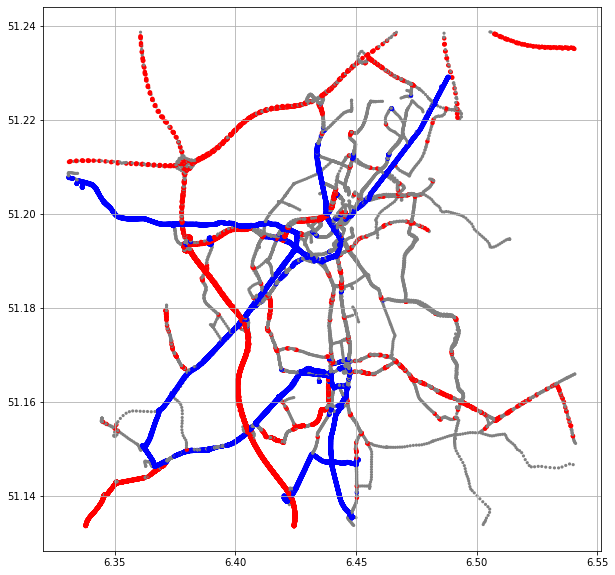

In [24]:
plot(getisConsumption_df)

In [ ]:
map(getisConsumption_df, 'Consumption')

### Implementation of Aggregation by Grid (From group 4)

In [5]:
import os
from math import floor, ceil
from scipy import interpolate
from statistics import mean
import pandas as pd
import geopandas as gpd
import numpy as np
import datetime
import random
import string
from copy import copy

import folium
#import movingpandas as mpd
from copy import copy
from shapely.geometry import Point, LineString, Polygon
import geopandas as gpd
import json
from branca.colormap import linear
import enum

In [6]:
#importing and checking data
df = from_geofeather('Data/Monchengladbach_50.feather')
df.head()

,index,id,time,geometry,GPS Bearing.value,GPS Bearing.unit,Intake Temperature.value,Intake Temperature.unit,MAF.value,MAF.unit,...,Consumption.value,Consumption.unit,Throttle Position.value,Throttle Position.unit,track.appVersion,track.touVersion,O2 Lambda Voltage.value,O2 Lambda Voltage.unit,O2 Lambda Voltage ER.value,O2 Lambda Voltage ER.unit
0,0,5b46294f44ea850910a1c1e0,2018-07-11T06:07:23,POINT (6.41455 51.20328),117.943870,deg,28.000001,c,35.669282,l/s,...,NaN,None,NaN,None,None,None,NaN,None,NaN,None
1,1,5b46294f44ea850910a1c1e2,2018-07-11T06:07:28,POINT (6.41512 51.20308),115.088323,deg,28.000000,c,31.446508,l/s,...,NaN,None,NaN,None,None,None,NaN,None,NaN,None
2,2,5b46294f44ea850910a1c1e3,2018-07-11T06:07:33,POINT (6.41564 51.20299),106.541059,deg,28.000000,c,28.072108,l/s,...,NaN,None,NaN,None,None,None,NaN,None,NaN,None
3,3,5b46294f44ea850910a1c1e4,2018-07-11T06:07:38,POINT (6.41615 51.20291),99.885196,deg,28.000000,c,33.429661,l/s,...,NaN,None,NaN,None,None,None,NaN,None,NaN,None
4,4,5b46294f44ea850910a1c1e5,2018-07-11T06:07:43,POINT (6.41671 51.20282),104.435649,deg,27.999999,c,25.774274,l/s,...,NaN,None,NaN,None,None,None,NaN,None,NaN,None


In [8]:
def aggregateByGrid(df,field,summary,gridSize):
        """
        Aggregates the specified field with chosen summary type and user defined grid size. returns aggregated grids with summary
        Parameters
        ----------
        df : geopandas dataframe
        field : string
            field to be summarized.
        summary : string
            type of summary to be sumarized. eg. min, max,sum, median
        gridSize : float
            the size of grid on same unit as geodataframe coordinates. 
        Returns
        -------
        geodataframe
            Aggregated grids with summary on i
            t
        """
        def round_down(num, divisor):
            return floor(num / divisor) * divisor
        def round_up(num, divisor):
            return ceil(num / divisor) * divisor
        xmin,ymin,xmax,ymax =  df.total_bounds
        height,width=gridSize,gridSize
        top,left=round_up(ymax,height),round_down(xmin,width)
        bottom,right=round_down(ymin,height),round_up(xmax,width)
    
    
        rows = int((top -bottom) /  height)+1
        cols = int((right -left) / width)+1
    
        XleftOrigin = left
        XrightOrigin = left + width
        YtopOrigin = top
        YbottomOrigin = top- height
        polygons = []
        for i in range(cols):
            Ytop = YtopOrigin
            Ybottom =YbottomOrigin
            for j in range(rows):
                polygons.append(Polygon([(XleftOrigin, Ytop), (XrightOrigin, Ytop), (XrightOrigin, Ybottom), (XleftOrigin, Ybottom)]))
                Ytop = Ytop - height
                Ybottom = Ybottom - height
            XleftOrigin = XleftOrigin + width
            XrightOrigin = XrightOrigin + width
    
        grid = gpd.GeoDataFrame({'geometry':polygons})
        grid.crs=df.crs
       
        #Assign gridid
        numGrid=len(grid)
        grid['gridId']=list(range(numGrid))
    
        #Identify gridId for each point
        points_identified= gpd.sjoin(df,grid,op='within')
    
        #group points by gridid and calculate mean Easting, store it as dataframe
        #delete if field already exists
        if field in grid.columns:
            del grid[field]
        grouped = points_identified.groupby('gridId')[field].agg(summary)
        grouped_df=pd.DataFrame(grouped)
        
        new_grid=grid.join(grouped_df, on='gridId').fillna(0)
        new_grid['x_centroid'],new_grid['y_centroid']=new_grid.geometry.centroid.x,new_grid.geometry.centroid.y
        grid=new_grid
        return grid

In [9]:
grid = aggregateByGrid(df,'Speed.value','mean',0.001) #approx 1 km

In [10]:
type(grid)

geopandas.geodataframe.GeoDataFrame

In [11]:
grid

,geometry,gridId,Speed.value,x_centroid,y_centroid
0,"POLYGON ((6.33100 51.23000, 6.33200 51.23000, ...",0,0.0,6.3315,51.2295
1,"POLYGON ((6.33100 51.22900, 6.33200 51.22900, ...",1,0.0,6.3315,51.2285
2,"POLYGON ((6.33100 51.22800, 6.33200 51.22800, ...",2,0.0,6.3315,51.2275
3,"POLYGON ((6.33100 51.22700, 6.33200 51.22700, ...",3,0.0,6.3315,51.2265
4,"POLYGON ((6.33100 51.22600, 6.33200 51.22600, ...",4,0.0,6.3315,51.2255
...,...,...,...,...,...
20477,"POLYGON ((6.53900 51.13700, 6.54000 51.13700, ...",20477,0.0,6.5395,51.1365
20478,"POLYGON ((6.53900 51.13600, 6.54000 51.13600, ...",20478,0.0,6.5395,51.1355
20479,"POLYGON ((6.53900 51.13500, 6.54000 51.13500, ...",20479,0.0,6.5395,51.1345
20480,"POLYGON ((6.53900 51.13400, 6.54000 51.13400, ...",20480,0.0,6.5395,51.1335


In [12]:
def plotAggregate(grid,field):
        """
        Plots the aggregated data on grid. Please call aggregateByGrid function before this step.
        Parameters
        ----------
        grid :polygon geodataframe
            The grid geodataframe with grid and aggregated data in a column. Grid shoud have grid id or equivalent unique ids
        field : string
            Fieldname with aggregated data
        Returns
        -------
        m : folium map object
            Folium map with openstreetmap as base.
        """
        #Prepare for grid plotting using folium
        grid.columns=[cols.replace('.', '_') for cols in grid.columns]
        field=field.replace('.','_')
        #Convert grid id to string
        grid['gridId']=grid['gridId'].astype(str)
        #only select grid with non zero values
        grid=grid[grid[field]>0]
        
        #Convert data to geojson and csv 
        atts=pd.DataFrame(grid.drop(columns=['geometry','x_centroid','y_centroid']))
        grid.to_file("grids.geojson", driver='GeoJSON')
        atts.to_csv("attributes.csv", index=False)
        
        #load spatial and non-spatial data
        data_geojson_source="grids.geojson"
        data_geojson=json.load(open(data_geojson_source))
        
        #Get coordiantes for map centre
        lat=grid.geometry.centroid.y.mean()
        lon=grid.geometry.centroid.x.mean()
        #Intialize a new folium map object
        m = folium.Map(location=[lat,lon],zoom_start=8,tiles='OpenStreetMap')
        # Configure geojson layer
        folium.GeoJson(data_geojson).add_to(m)
    
        #add attribute data
        attribute_pd=pd.read_csv("attributes.csv")
        attribute=pd.DataFrame(attribute_pd)
        #Convert gridId to string to ensure it matches with gridId
        attribute['gridId']=attribute['gridId'].astype(str)
        
        # construct color map
        minvalue=attribute[field].min()
        maxvalue=attribute[field].max()
        colormap_rn = linear.YlOrRd_09.scale(minvalue,maxvalue)
    
        #Create Dictionary for colormap
        population_dict_rn = attribute.set_index('gridId')[field]
    
        #create map
        folium.GeoJson(
           data_geojson,
            name='Choropleth map',
            style_function=lambda feature: {
                'fillColor': colormap_rn(population_dict_rn[feature['properties']['gridId']]),
                'color': 'black',
                'weight': 0.5,
                'dashArray': '5, 5',
                'fillOpacity':0.5
                   },
            highlight_function=lambda feature:{'weight':3,'color':'black','fillOpacity':1},
            tooltip=folium.features.GeoJsonTooltip(fields=[field],aliases=[field])
        ).add_to(m)
    
       #format legend
        field=field.replace("_"," ")
        # add a legend
        colormap_rn.caption = '{value} per grid'.format(value=field)
        colormap_rn.add_to(m)
    
        # add a layer control
        folium.LayerControl().add_to(m)
        return m

In [13]:
plotAggregate(grid,'Speed.value')